<font color='Blue' size=5><b>Here in this task, we use two algorithms for clustering </font></b>

<font color='red' size=5><b>1. KMeans</font></b>

<font color='red' size=5><b>2. Birch</font></b>

In [ ]:
# Import required libraries

import os
import cv2
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans, Birch
from keras.models import Sequential
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from pathlib import Path
import glob
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import warnings

In [ ]:
warnings.filterwarnings("ignore")

In [ ]:
# Mount google drive on google colab

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#This is the path that I store images

path = '/content/drive/MyDrive/ML_Project_Dataset/'

In [ ]:
# Create a resnet50 model for feature extraction. We use the weights of the base model which is trained on ImageNet dataset

model = Sequential()
model.add(ResNet50(include_top=False, pooling='avg', weights='imagenet'))
model.layers[0].trainable = False

94765736/94765736 [==============================] - 4s 0us/step


In [ ]:
# Create a function extract feature vector from image dataset using resnet50

images = Path(path).glob("*.jpg")
images_path = [str(p) for p in images]

def extract_vector(images_path):
    resnet_feature_list = []

    for im in images_path:

        im = cv2.imread(im)
        im = cv2.resize(im,(224,224))
        img = preprocess_input(np.expand_dims(im.copy(), axis=0))
        resnet_feature = model.predict(img)
        resnet_feature_np = np.array(resnet_feature)
        resnet_feature_list.append(resnet_feature_np.flatten())

    return np.array(resnet_feature_list)

In [ ]:
# Cluster the images into desired number of clusters by two algorithms of KMeans and DBSCAN

def clustering(algorithm, features, num_clusters):

  if algorithm=='KMeans':

    cluster = KMeans(n_clusters=num_clusters, random_state=0)
    cluster.fit(features)

  elif algorithm=='Birch':

    cluster = Birch(n_clusters=num_clusters)
    cluster.fit(features)

  else:
    raise Exception("Invalid Algorithm")

  labels = cluster.labels_
  image_label = list(zip(images_path, labels))

  classes = []
  for i in range(num_clusters):

    cls = [j for j in image_label if j[1]==i]
    classes.append(cls)

  return classes, labels

In [ ]:
# there is a function to visualize the clusters. From each cluster, we show 8 images to understand how our clustering algorithm works

def visualize(classes):

  num_class = len(classes)
  row = num_class
  column = 5

  fig = plt.figure(figsize=(10, 2*row))
  for i in range(num_class):

    for j in range(column):

      img = plt.imread(classes[i][j][0])
      fig.add_subplot(row, column, i*column + j + 1)
      plt.imshow(img)
      plt.title("_".join(classes[i][j][0].split('/')[-1].split('_')[1:-1]), fontsize=10)
      plt.axis('off')

In [ ]:
# Using this function we print silhouette score and show five images of each cluster in a row
def show_results(algorithm, features, num_clusters):

  classes, labels = clustering(algorithm, features, num_clusters)
  visualize(classes)
  print('Solihouette score : %s'%silhouette_score(features, labels))

In [ ]:
%%capture
features = extract_vector(images_path)

Solihouette score : 0.1092478


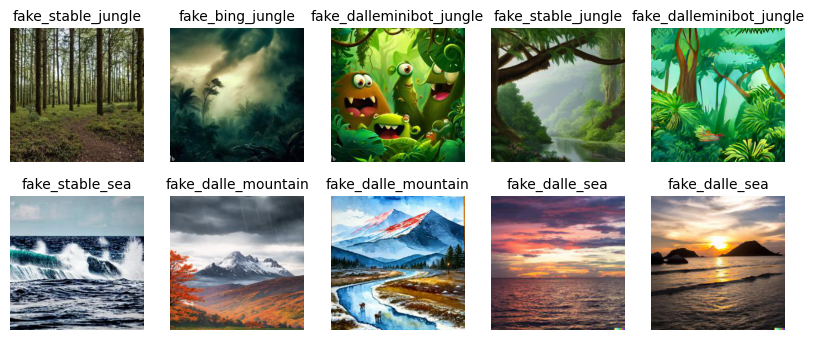

In [ ]:
show_results('KMeans', features, 2)

Solihouette score : 0.10351878


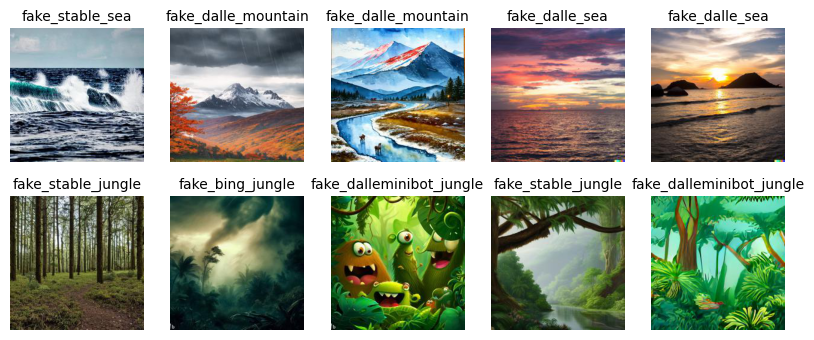

In [ ]:
show_results('Birch', features, 2)

Solihouette score : 0.09292032


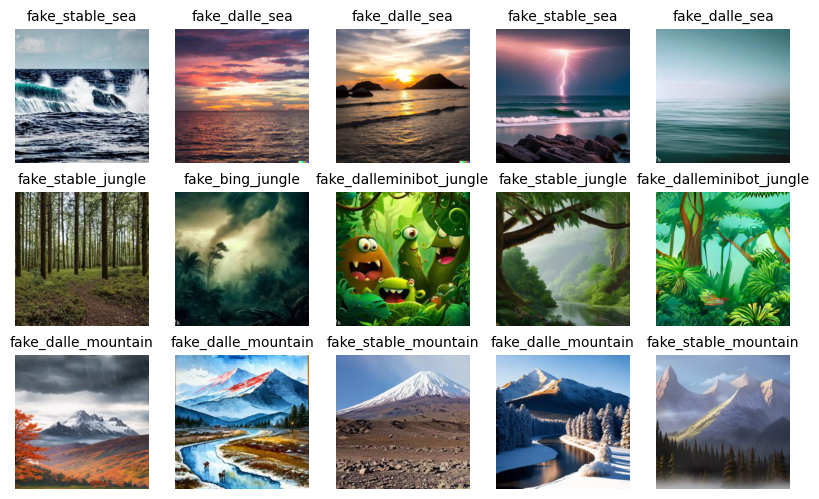

In [ ]:
show_results('KMeans', features, 3)

Solihouette score : 0.07865451


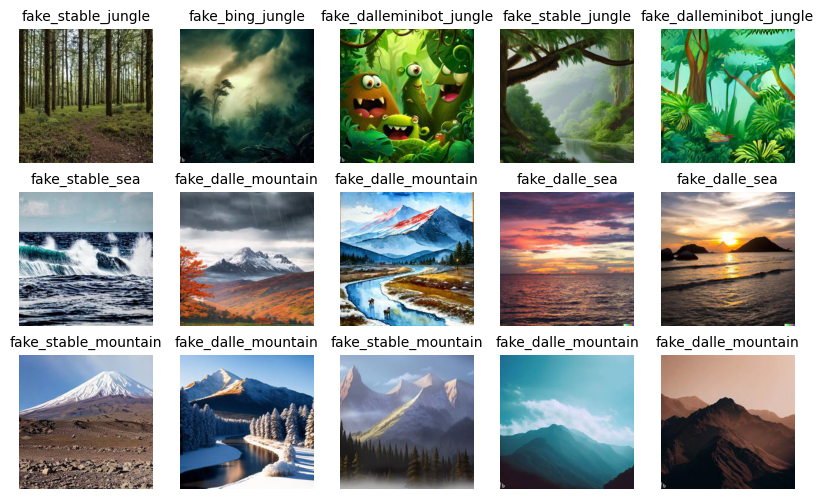

In [ ]:
show_results('Birch', features, 3)

Solihouette score : 0.067829154


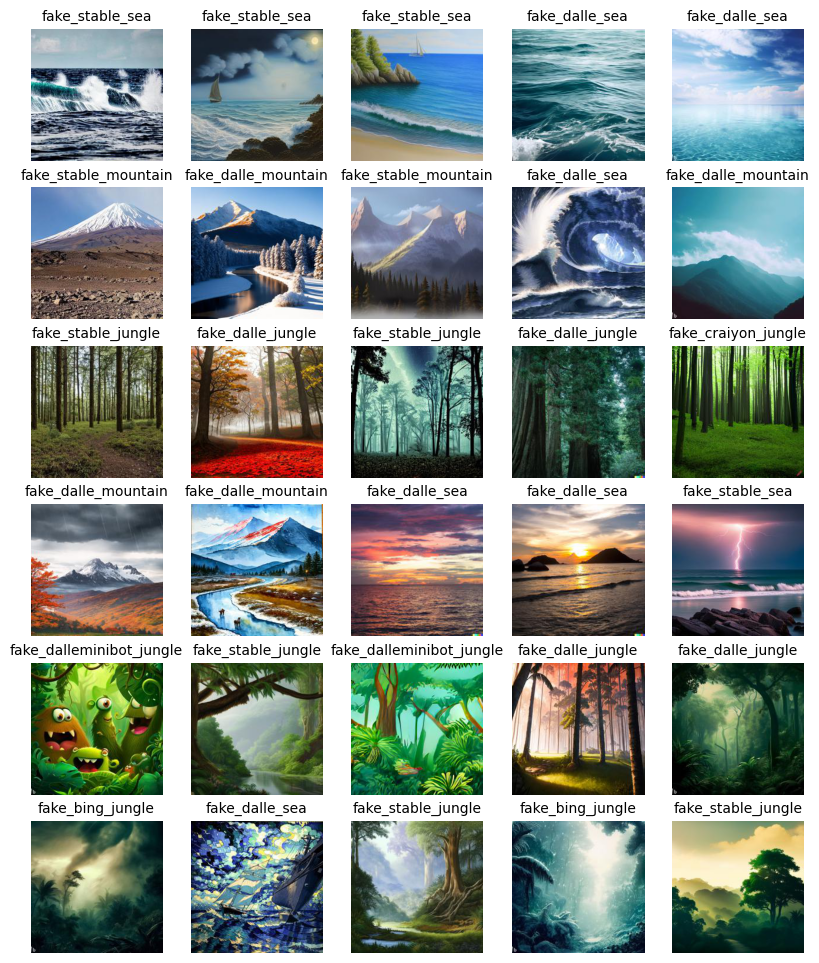

In [ ]:
show_results('KMeans', features, 6)

Solihouette score : 0.058128737


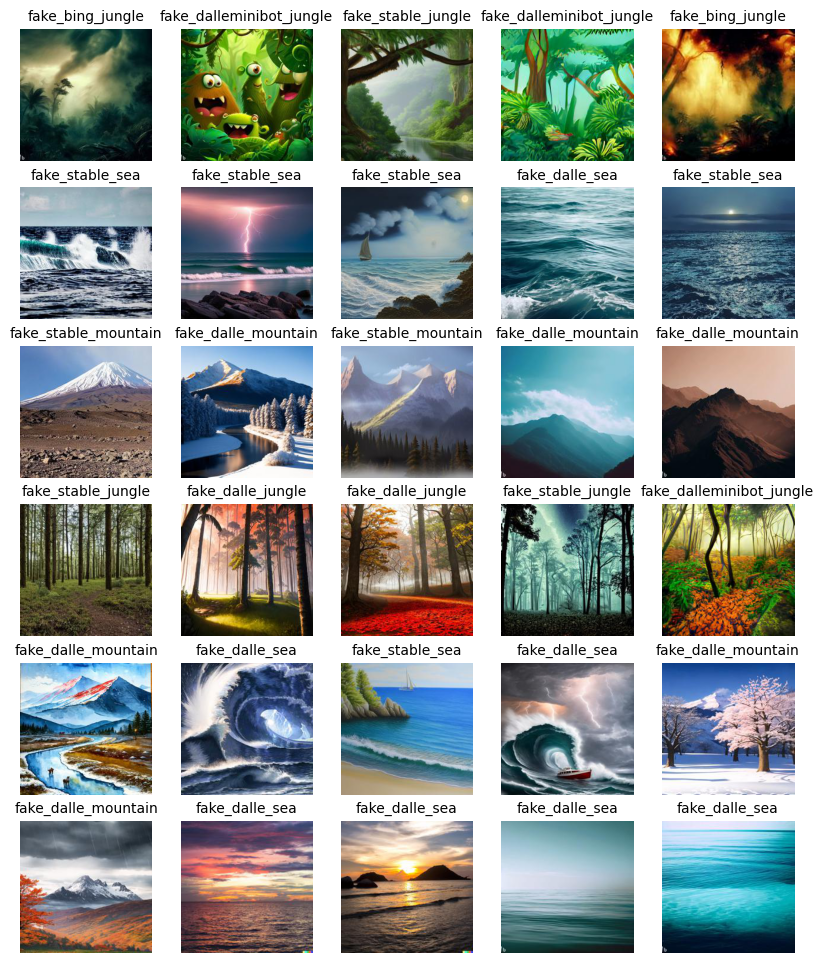

In [ ]:
show_results('Birch', features, 6)

Solihouette score : 0.039137375


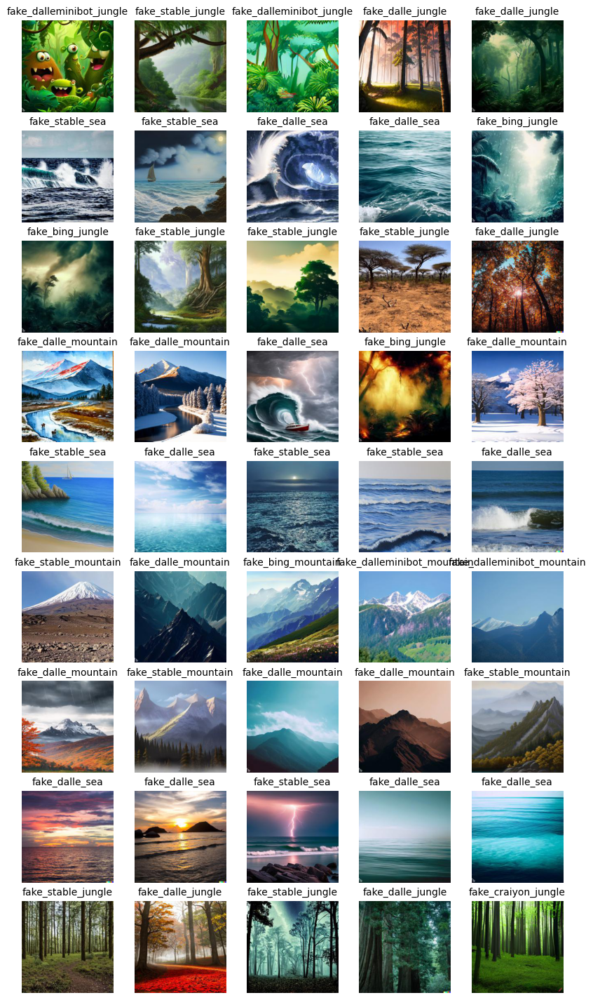

In [ ]:
show_results('KMeans', features, 9)

Solihouette score : 0.04081527


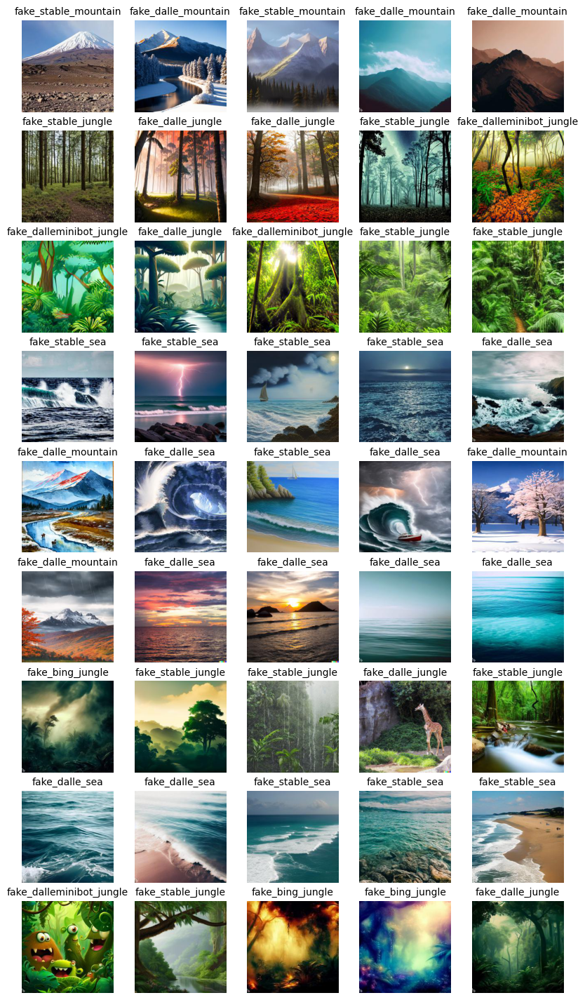

In [ ]:
show_results('Birch', features, 9)

Solihouette score : 0.019386228


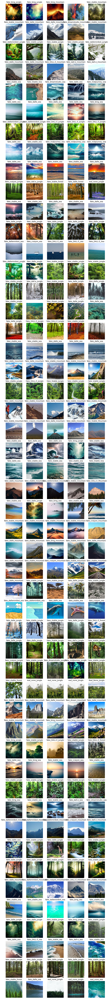

In [ ]:
show_results('KMeans', features, 50)

Solihouette score : 0.007826764


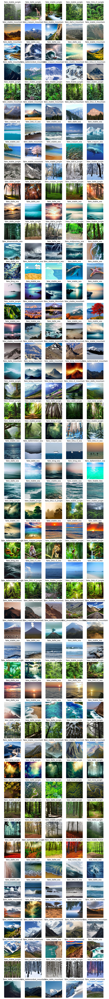

In [ ]:
show_results('Birch', features, 50)